<a href="https://colab.research.google.com/github/RAvila-bioeng/Cell-Count/blob/main/Final_de_Cell_Count.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Cell count
Authors: Nacho Cañas and Roberto Ávila


Justificación teórica (por qué eliges ciertos métodos, parámetros, filtros, etc.).

Código limpio (sin errores, con comentarios y funciones si puedes).

Resultados y conclusiones (mostrar imágenes procesadas y número de células detectadas).

### Código de Primer día:

In [1]:
!pip install onedrivedownloader
from onedrivedownloader import download

PATH_FILE = 'https://universidadfv-my.sharepoint.com/:i:/g/personal/alberto_desantos_ufv_es/ESWcU3soWRFFhKUIBOoH2uUBZq6M5T5jrYA-cYK1YprwJg?e=LBz2yk'
download(url = PATH_FILE, filename = 'image1antigenandcell.jpg', unzip=False, force_download=True, clean=False)

100%|██████████| 46.8k/46.8k [00:00<00:00, 648kiB/s]


'image1antigenandcell.jpg'

In [2]:
PATH_FILE = 'https://universidadfv-my.sharepoint.com/:i:/g/personal/alberto_desantos_ufv_es/EVq7WDpsmUdNpimem9qtc-0Btj8E9McUzg9IccKZN2f-rg?e=tNV0Dz'
download(url = PATH_FILE, filename = 'image2cell.jpg', unzip=False, force_download=True, clean=False)

100%|██████████| 336k/336k [00:00<00:00, 750kiB/s]


'image2cell.jpg'

In [3]:
pip install --upgrade scikit-image

/tmp/ipython-input-1740312020.py:9: FutureWarning: `imshow` is deprecated since version 0.25 and will be removed in version 0.27. Please use `matplotlib`, `napari`, etc. to visualize images.
  io.imshow(image1antigenandcell)


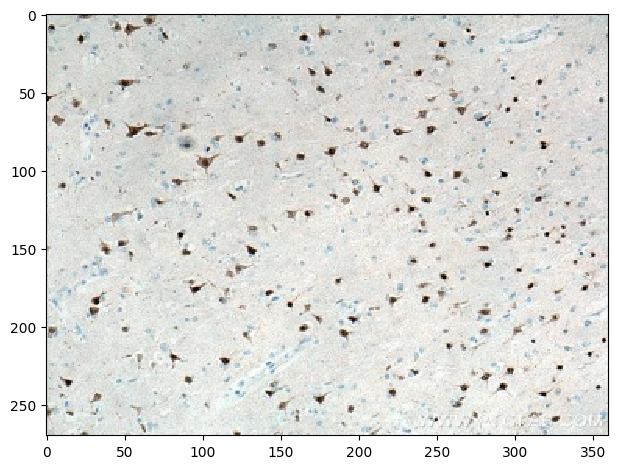

In [4]:
from skimage import io
import matplotlib.pyplot as plt

# Cargar imágenes
image1antigenandcell = io.imread('/content/image1antigenandcell.jpg')
image2cell = io.imread('/content/image2cell.jpg')

# Mostrar las imágenes
io.imshow(image1antigenandcell)

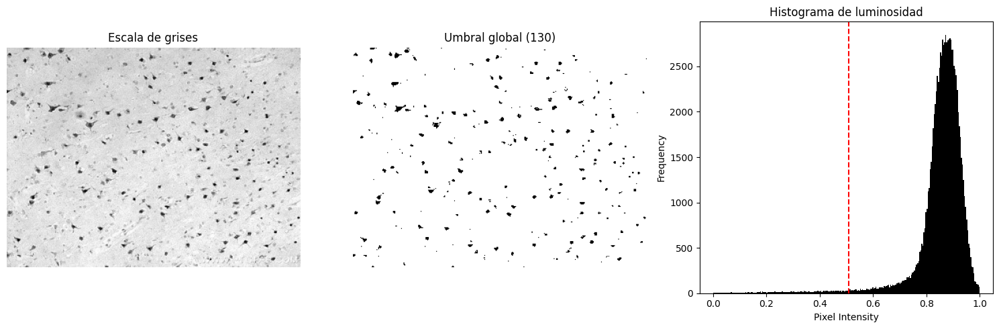

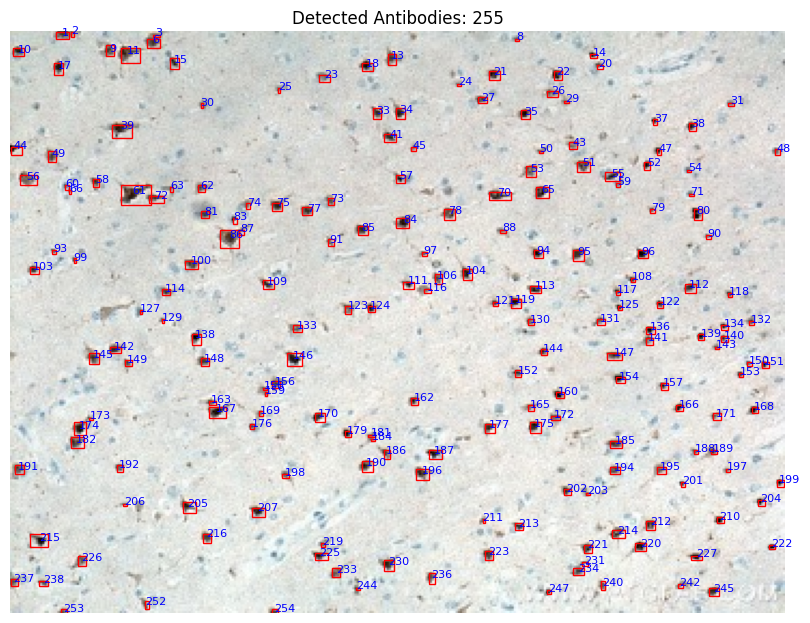

Se detectaron 255 anticuerpos en total.


In [5]:
from skimage import color, filters, measure, util
import matplotlib.pyplot as plt
import numpy as np

# Escala de grises
gray = color.rgb2gray(image1antigenandcell)

# Umbral
limite = 130 / 255.0
th_global = gray > limite  # Umbralización binaria


fig, axs = plt.subplots(1, 3, figsize=(15, 5))

axs[0].imshow(gray, cmap="gray")
axs[0].set_title("Escala de grises")
axs[0].axis("off")

axs[1].imshow(th_global, cmap="gray")
axs[1].set_title(f"Umbral global ({int(limite*255)})")
axs[1].axis("off")

axs[2].hist(gray.ravel(), bins=256, range=[0,1], color="black")
axs[2].set_title("Histograma de luminosidad")
axs[2].axvline(limite, color="red", linestyle="--")
axs[2].set_xlabel("Pixel Intensity")
axs[2].set_ylabel("Frequency")

plt.tight_layout()
plt.show()

# detección y etiquetado de manchas
# Invertimos la imagen si es necesario
th_invertida = np.invert(th_global)

# Etiquetar componentes conectados
labels = measure.label(th_invertida, connectivity=2)

# Crear una copia RGB de la imagen binaria para visualizar
output = color.gray2rgb(util.img_as_ubyte(th_global))

# Dibujar rectángulos y etiquetas
fig, ax = plt.subplots(figsize=(10, 8))
ax.imshow(image1antigenandcell)

for region in measure.regionprops(labels):
    if region.area > 1:
        minr, minc, maxr, maxc = region.bbox
        cy, cx = region.centroid
        # Dibujar rectángulo (rojo)
        rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr,
                             edgecolor='red', facecolor='none', linewidth=1)
        ax.add_patch(rect)
        # Número de etiqueta (azul)
        ax.text(cx, cy, str(region.label), color='blue', fontsize=8)

ax.set_title(f"Detected Antibodies: {labels.max()}")
ax.axis("off")
plt.show()

print(f"Se detectaron {labels.max()} anticuerpos en total.")


In [6]:
# Extraemos la información de los detalles de la imagen en tuplas:
ancho, alto, capas = image1antigenandcell.shape
print('Ancho: '+str(ancho))
print('Alto: '+str(alto))
print('Capas: '+str(capas))
#Como podemos ver tiene 3 capas

Ancho: 270
Alto: 360
Capas: 3


### Código Segundo día

### Código 1: Umbral Global
Pros:



*   Más simple y rápido computacionalmente
*   Funciona bien cuando hay buena separación entre fondo y células
*   Fácil de interpretar y ajustar

Contras:

*   Muy sensible a variaciones de iluminación
*   Umbral fijo (190) puede no funcionar bien en todas las imágenes
*   No maneja bien iluminación desigual

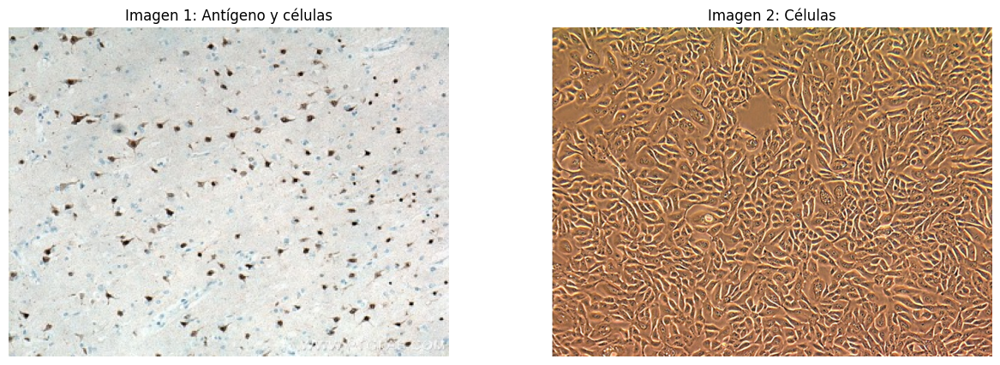

Se detectaron 576 manchas en total.


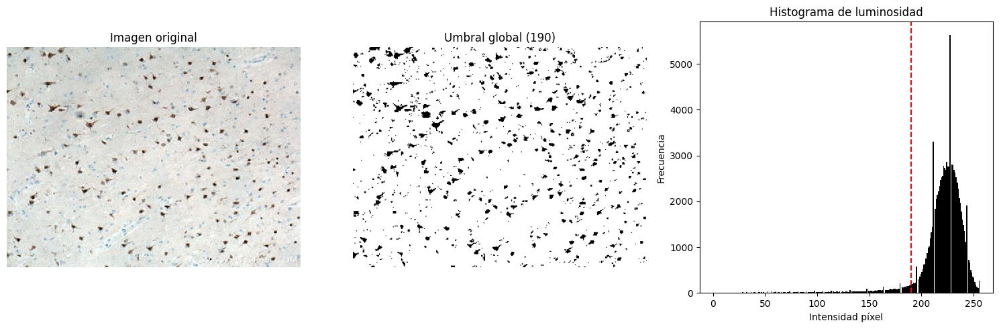

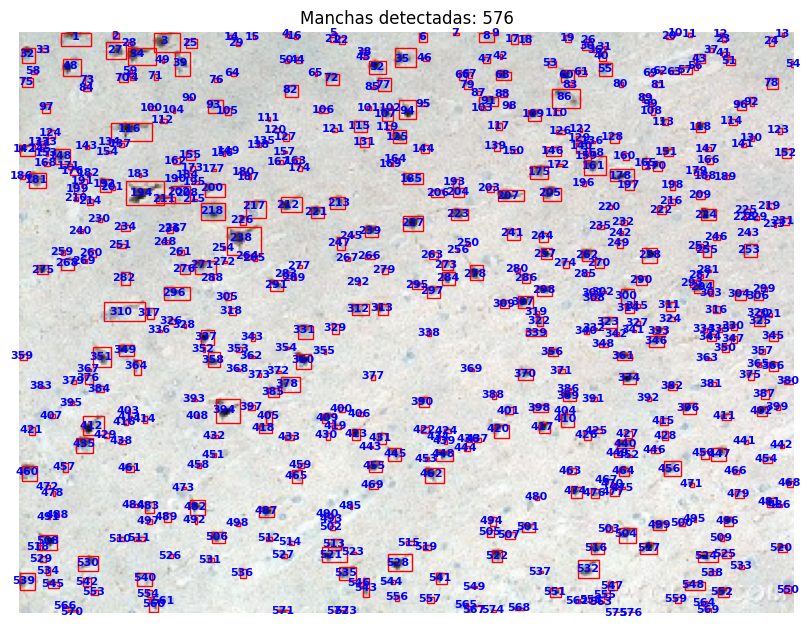

In [7]:
from skimage.morphology import label

# Mostrar las imágenes
fig, axs = plt.subplots(1, 2, figsize=(15, 5))
axs[0].imshow(image1antigenandcell)
axs[0].set_title("Imagen 1: Antígeno y células")
axs[0].axis("off")
axs[1].imshow(image2cell)
axs[1].set_title("Imagen 2: Células")
axs[1].axis("off")
plt.show()

# Función para convertir RGB a HSV y extraer canal V
# Esta función es útil porque la conversión a HSV y extracción del canal V
# es una operación común en análisis de imágenes biomédicas
def extraer_canal_luminosidad(imagen_rgb):
    """
    Convierte una imagen RGB a HSV y extrae el canal V (luminosidad).

    Args:
        imagen_rgb: numpy array con imagen en formato RGB

    Returns:
        Canal V normalizado en rango [0, 255] como uint8
    """
    hsv_img = color.rgb2hsv(imagen_rgb)
    v_channel = hsv_img[:, :, 2]
    # Convertir de [0,1] a [0,255]
    v_channel_uint8 = (v_channel * 255).astype(np.uint8)
    return v_channel_uint8

# Función para aplicar umbral global
# Útil como función porque encapsula la lógica de umbralización
# y permite reutilizarla fácilmente con diferentes imágenes
def aplicar_umbral_global(imagen_gris, umbral):
    """
    Aplica umbralización global a una imagen en escala de grises.

    Args:
        imagen_gris: numpy array en escala de grises
        umbral: valor del umbral (0-255)

    Returns:
        Imagen binaria umbralizada
    """
    th_binary = imagen_gris > umbral
    return (th_binary * 255).astype(np.uint8)

# Función para detectar y etiquetar manchas
# Esta función es especialmente útil porque combina varios pasos
# de análisis de componentes conectados en una sola operación reutilizable
def detectar_manchas(imagen_binaria, area_minima=1):
    """
    Detecta componentes conectados (manchas) en una imagen binaria.

    Args:
        imagen_binaria: numpy array binario (0 o 255)
        area_minima: área mínima para considerar una mancha válida

    Returns:
        tuple: (número de manchas, imagen etiquetada, propiedades de regiones)
    """
    # Convertir a booleano para label
    binary = imagen_binaria > 0

    # Etiquetar componentes conectados
    labeled_image = label(binary)

    # Extraer propiedades de las regiones
    regions = measure.regionprops(labeled_image)

    # Filtrar por área mínima
    regions_filtradas = [r for r in regions if r.area > area_minima]

    return len(regions_filtradas), labeled_image, regions_filtradas

# Función para visualizar manchas detectadas
# Útil para evitar repetir código de visualización y mantener
# consistencia en cómo se muestran los resultados
def visualizar_manchas(imagen_original, regions, titulo="Manchas detectadas"):
    """
    Visualiza las manchas detectadas con rectángulos y etiquetas.

    Args:
        imagen_original: imagen RGB original
        regions: lista de propiedades de regiones de scikit-image
        titulo: título para la figura
    """
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.imshow(imagen_original)

    for i, region in enumerate(regions, start=1):
        minr, minc, maxr, maxc = region.bbox
        rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr,
                            fill=False, edgecolor='red', linewidth=1)
        ax.add_patch(rect)

        cy, cx = region.centroid
        ax.text(cx, cy, str(i), color='blue', fontsize=8,
               ha='center', va='center', weight='bold')

    ax.set_title(f"{titulo}: {len(regions)}")
    ax.axis("off")
    plt.show()

# PIPELINE DE PROCESAMIENTO

# Paso 1: Extraer canal de luminosidad
v_channel = extraer_canal_luminosidad(image1antigenandcell)

# Paso 2: Aplicar umbral global
limite = 190
th_global = aplicar_umbral_global(v_channel, limite)

# Paso 3: Invertir la imagen (células en blanco sobre fondo negro)
th_invertida = 255 - th_global

# Paso 4: Detectar manchas
num_manchas, labeled_img, regions = detectar_manchas(th_invertida, area_minima=1)

print(f"Se detectaron {num_manchas} manchas en total.")

# Visualización del proceso
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

axs[0].imshow(image1antigenandcell)
axs[0].set_title("Imagen original")
axs[0].axis("off")

axs[1].imshow(th_global, cmap='gray')
axs[1].set_title(f"Umbral global ({limite})")
axs[1].axis("off")

axs[2].hist(v_channel.ravel(), bins=256, range=[0, 256], color="black")
axs[2].axvline(limite, color="red", linestyle="--")
axs[2].set_title("Histograma de luminosidad")
axs[2].set_xlabel("Intensidad píxel")
axs[2].set_ylabel("Frecuencia")

plt.tight_layout()
plt.show()

# Visualizar manchas detectadas
visualizar_manchas(image1antigenandcell, regions, "Manchas detectadas")

### Código 2: K-Means + Umbral Adaptativo
Pros:
*   Puede generar más ruido sin morfología
*   K-Means reduce la complejidad de color, facilitando la segmentación
*   Umbral adaptativo maneja mejor la iluminación desigual

Contras:

*   Puede generar más ruido sin morfología
*   K=2 puede ser insuficiente para imágenes complejas, en este caos lo ponemos así ya que el fondo no es el mismo tono de gris, si pusiesemos K=3 estaría detectando tambien parte del fondo.
*   Mayor costo computacional que el anterior

Se detectaron 386 manchas con umbral adaptativo.


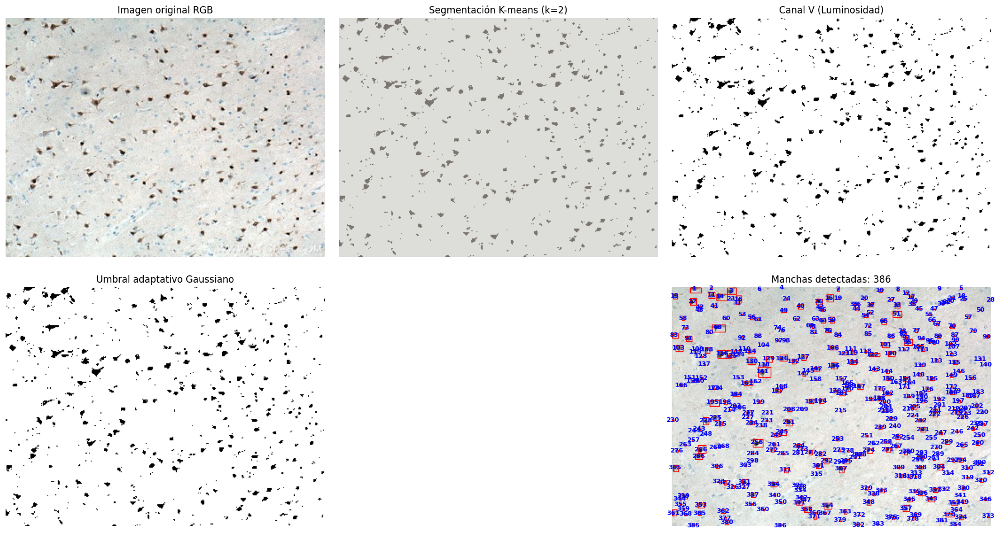

In [8]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, color, measure
from skimage.morphology import label
from skimage.filters import threshold_local
from sklearn.cluster import KMeans

# Cargar imagen (asumiendo que ya está cargada del código anterior)
# image1antigenandcell = io.imread('/content/image1antigenandcell.jpg')

# Función para segmentar con K-Means
# Esta función es útil porque K-Means es una técnica común de pre-procesamiento
# que puede aplicarse a diferentes imágenes con distintos valores de k
def segmentar_kmeans(imagen_rgb, n_clusters=2):
    """
    Segmenta una imagen RGB usando K-Means clustering.

    Args:
        imagen_rgb: numpy array con imagen RGB
        n_clusters: número de clusters para K-Means

    Returns:
        Imagen segmentada con colores de los centroides
    """
    # Reshape a vector de píxeles
    pixel_vals = imagen_rgb.reshape((-1, 3))
    pixel_vals = np.float32(pixel_vals)

    # Aplicar K-Means
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
    labels = kmeans.fit_predict(pixel_vals)
    centers = kmeans.cluster_centers_

    # Reconstruir imagen segmentada
    centers = np.uint8(centers)
    segmented_data = centers[labels]
    segmented_image = segmented_data.reshape(imagen_rgb.shape)

    return segmented_image

# Función para aplicar umbral adaptativo
# Útil como función porque permite ajustar fácilmente los parámetros
# del umbral adaptativo sin repetir código
def aplicar_umbral_adaptativo(imagen_gris, block_size=8, offset=2):
    """
    Aplica umbralización adaptativa Gaussiana.

    Args:
        imagen_gris: numpy array en escala de grises
        block_size: tamaño de vecindad (debe ser impar)
        offset: constante a restar del umbral local

    Returns:
        Imagen binaria umbralizada
    """
    # threshold_local calcula el umbral local
    local_thresh = threshold_local(imagen_gris, block_size, offset=offset, method='gaussian')
    th_binary = imagen_gris > local_thresh
    return (th_binary * 255).astype(np.uint8)

# Reutilizamos las funciones del código anterior
def extraer_canal_luminosidad(imagen_rgb):
    hsv_img = color.rgb2hsv(imagen_rgb)
    v_channel = hsv_img[:, :, 2]
    v_channel_uint8 = (v_channel * 255).astype(np.uint8)
    return v_channel_uint8

def detectar_manchas(imagen_binaria, area_minima=1):
    binary = imagen_binaria > 0
    labeled_image = label(binary)
    regions = measure.regionprops(labeled_image)
    regions_filtradas = [r for r in regions if r.area > area_minima]
    return len(regions_filtradas), labeled_image, regions_filtradas

def visualizar_manchas(imagen_original, regions, titulo="Manchas detectadas"):
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.imshow(imagen_original)

    for i, region in enumerate(regions, start=1):
        minr, minc, maxr, maxc = region.bbox
        rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr,
                            fill=False, edgecolor='red', linewidth=1)
        ax.add_patch(rect)

        cy, cx = region.centroid
        ax.text(cx, cy, str(i), color='blue', fontsize=8,
               ha='center', va='center', weight='bold')

    ax.set_title(f"{titulo}: {len(regions)}")
    ax.axis("off")
    plt.show()

# PIPELINE DE PROCESAMIENTO

# Paso 1: Segmentación con K-Means
k = 2
segmented_image = segmentar_kmeans(image1antigenandcell, n_clusters=k)

# Paso 2: Extraer canal de luminosidad de la imagen segmentada
v_channel = extraer_canal_luminosidad(segmented_image)

# Paso 3: Aplicar umbral adaptativo
th_adapt = aplicar_umbral_adaptativo(v_channel, block_size=201, offset=1)

# Paso 4: Invertir imagen
th_invertida = 255 - th_adapt

# Paso 5: Detectar manchas
num_manchas, labeled_img, regions = detectar_manchas(th_invertida, area_minima=1)

print(f"Se detectaron {num_manchas} manchas con umbral adaptativo.")

# Visualización del proceso completo
fig, axs = plt.subplots(2, 3, figsize=(18, 10))

axs[0, 0].imshow(image1antigenandcell)
axs[0, 0].set_title("Imagen original RGB")
axs[0, 0].axis("off")

axs[0, 1].imshow(segmented_image)
axs[0, 1].set_title(f"Segmentación K-means (k={k})")
axs[0, 1].axis("off")

axs[0, 2].imshow(v_channel, cmap='gray')
axs[0, 2].set_title("Canal V (Luminosidad)")
axs[0, 2].axis("off")

axs[1, 0].imshow(th_adapt, cmap='gray')
axs[1, 0].set_title("Umbral adaptativo Gaussiano")
axs[1, 0].axis("off")

axs[1, 1].axis("off")  # Espacio vacío

axs[1, 2].imshow(image1antigenandcell)
for i, region in enumerate(regions, start=1):
    minr, minc, maxr, maxc = region.bbox
    rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr,
                        fill=False, edgecolor='red', linewidth=1)
    axs[1, 2].add_patch(rect)
    cy, cx = region.centroid
    axs[1, 2].text(cx, cy, str(i), color='blue', fontsize=8,
                  ha='center', va='center', weight='bold')
axs[1, 2].set_title(f"Manchas detectadas: {num_manchas}")
axs[1, 2].axis("off")

plt.tight_layout()
plt.show()

Desatisfechos con el código anterior decidimos usar la más extendida cv2 para poder ayudarnos más del trabajo de LLMs externas y repetir nuestra lógica con esta nueva librería. Un rápido análisis de los distintos pasos nos permitió identificar que el problema estaba ocn la detección de manchas después de haber aplicado el umbral, no todas las manchas se estaban marcando.
Este segundo código se verá que es exactamente el mismo pero en este caso se ha usado la lógica de detacción de manchas de cv2, haciendo un mix de ambas librerías y cogiendo loq ue más nos gusta de cada una.

Se detectaron 543 manchas con umbral adaptativo.


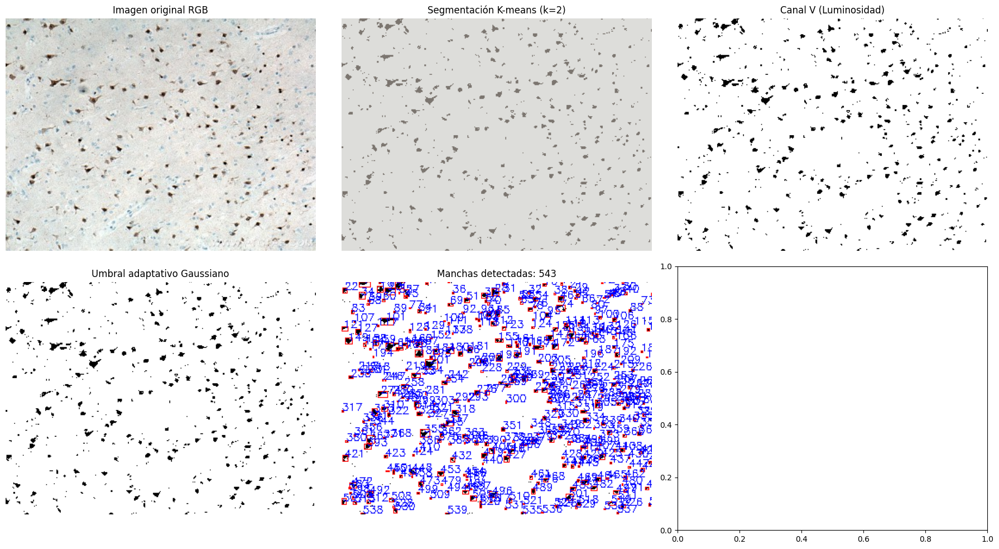

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, color, measure
from skimage.morphology import label
from skimage.filters import threshold_local
from sklearn.cluster import KMeans
from skimage import io, color, measure
from skimage.morphology import label
import cv2

# Cargar imagen (asumiendo que ya está cargada del código anterior)
# image1antigenandcell = io.imread('/content/image1antigenandcell.jpg')

# Función para segmentar con K-Means
# Esta función es útil porque K-Means es una técnica común de pre-procesamiento
# que puede aplicarse a diferentes imágenes con distintos valores de k
def segmentar_kmeans(imagen_rgb, n_clusters=2):
    """
    Segmenta una imagen RGB usando K-Means clustering.

    Args:
        imagen_rgb: numpy array con imagen RGB
        n_clusters: número de clusters para K-Means

    Returns:
        Imagen segmentada con colores de los centroides
    """
    # Reshape a vector de píxeles
    pixel_vals = imagen_rgb.reshape((-1, 3))
    pixel_vals = np.float32(pixel_vals)

    # Aplicar K-Means
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
    labels = kmeans.fit_predict(pixel_vals)
    centers = kmeans.cluster_centers_

    # Reconstruir imagen segmentada
    centers = np.uint8(centers)
    segmented_data = centers[labels]
    segmented_image = segmented_data.reshape(imagen_rgb.shape)

    return segmented_image

# Función para aplicar umbral adaptativo
# Útil como función porque permite ajustar fácilmente los parámetros
# del umbral adaptativo sin repetir código
def aplicar_umbral_adaptativo(imagen_gris, block_size=8, offset=2):
    """
    Aplica umbralización adaptativa Gaussiana.

    Args:
        imagen_gris: numpy array en escala de grises
        block_size: tamaño de vecindad (debe ser impar)
        offset: constante a restar del umbral local

    Returns:
        Imagen binaria umbralizada
    """
    # threshold_local calcula el umbral local
    local_thresh = threshold_local(imagen_gris, block_size, offset=offset, method='gaussian')
    th_binary = imagen_gris > local_thresh
    return (th_binary * 255).astype(np.uint8)

# Reutilizamos las funciones del código anterior
def extraer_canal_luminosidad(imagen_rgb):
    hsv_img = color.rgb2hsv(imagen_rgb)
    v_channel = hsv_img[:, :, 2]
    v_channel_uint8 = (v_channel * 255).astype(np.uint8)
    return v_channel_uint8

def detectar_manchas(imagen_binaria, area_minima=1):
    binary = imagen_binaria > 0
    labeled_image = label(binary)
    regions = measure.regionprops(labeled_image)
    regions_filtradas = [r for r in regions if r.area > area_minima]
    return len(regions_filtradas), labeled_image, regions_filtradas

def visualizar_manchas(imagen_original, regions, titulo="Manchas detectadas"):
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.imshow(imagen_original)

    for i, region in enumerate(regions, start=1):
        minr, minc, maxr, maxc = region.bbox
        rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr,
                            fill=False, edgecolor='red', linewidth=1)
        ax.add_patch(rect)

        cy, cx = region.centroid
        ax.text(cx, cy, str(i), color='blue', fontsize=8,
               ha='center', va='center', weight='bold')

    ax.set_title(f"{titulo}: {len(regions)}")
    ax.axis("off")
    plt.show()

# PIPELINE DE PROCESAMIENTO

# Paso 1: Segmentación con K-Means
k = 2
segmented_image = segmentar_kmeans(image1antigenandcell, n_clusters=k)

# Paso 2: Extraer canal de luminosidad de la imagen segmentada
v_channel = extraer_canal_luminosidad(segmented_image)

# Paso 3: Aplicar umbral adaptativo
th_adapt = aplicar_umbral_adaptativo(v_channel, block_size=201, offset=1)

# Paso 4: Invertir imagen
th_invertida = 255 - th_adapt

num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(th_invertida, connectivity=8)
output = cv2.cvtColor(th_adapt, cv2.COLOR_GRAY2BGR)

for i in range(1, num_labels):
    x, y, w, h, area = stats[i]
    cx, cy = centroids[i]
    if area > 1:  # filtro mínimo tamaño manchas
        cv2.rectangle(output, (x, y), (x + w, y + h), (0, 0, 255), 1)
        cv2.putText(output, str(i), (int(cx), int(cy)), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (255, 0, 0), 1)

print(f"Se detectaron {num_labels - 1} manchas con umbral adaptativo.")

# Visualización del proceso completo
fig, axs = plt.subplots(2, 3, figsize=(18, 10))

axs[0, 0].imshow(image1antigenandcell)
axs[0, 0].set_title("Imagen original RGB")
axs[0, 0].axis("off")

axs[0, 1].imshow(segmented_image)
axs[0, 1].set_title(f"Segmentación K-means (k={k})")
axs[0, 1].axis("off")

axs[0, 2].imshow(v_channel, cmap='gray')
axs[0, 2].set_title("Canal V (Luminosidad)")
axs[0, 2].axis("off")

axs[1, 0].imshow(th_adapt, cmap='gray')
axs[1, 0].set_title("Umbral adaptativo Gaussiano")
axs[1, 0].axis("off")

axs[1, 1].axis("off")  # Espacio vacío

# Manchas detectadas y etiquetadas
axs[1, 1].imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
axs[1, 1].set_title(f"Manchas detectadas: {num_labels - 1}")
axs[1, 1].axis("off")

plt.tight_layout()
plt.show()

### Código 3: Demostración
En este código únicamente queríamos hacer una demostración de una cualidad llamtiva de la imagen.
Como ya hemos explicado nuestro primer paso fue utilizar el método rudiemntario (pero útil) de umbralización para encontarr el número aproximado de anticuerpos en la imagen. Esto lo hicimos así ya que son claramente la parte más oscura de toda la imagen.
Siguiendo esta lógica, para detectar el número de células decidimos utilizar un método de quedarnos solo con la componente azul de la imagen ya que a simple vista las células son claramente el color azul más intenso que podemos enocntrar. Sin embargo, y como demostramos a continuación, esta imagen resulta tener la misma intensidad en todas sus componentes RGB, algo destacable y curioso.

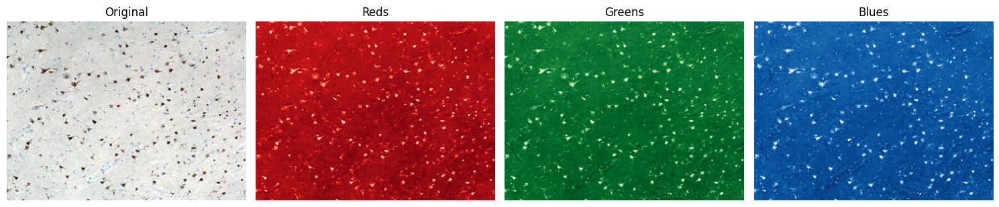

In [10]:
fig, axs = plt.subplots(1, capas + 1, figsize=(15, 5))



axs[0].imshow(image1antigenandcell)
axs[0].set_title("Original")
axs[0].axis("off")

colores=["Reds", "Greens", "Blues"]
for i in range(capas):
    axs[i+1].imshow(image1antigenandcell[:, :, i], cmap=colores[i])
    axs[i+1].set_title(colores[i])
    axs[i+1].axis("off")

plt.tight_layout() #esta linea solo hace que se ajuste a la página
plt.show()

In [11]:
# Calculate the average intensity for each channel
red_avg = np.mean(image1antigenandcell[:, :, 0])
green_avg = np.mean(image1antigenandcell[:, :, 1])
blue_avg = np.mean(image1antigenandcell[:, :, 2])

print(f"Average intensity of the Red channel: {red_avg:.2f}")
print(f"Average intensity of the Green channel: {green_avg:.2f}")
print(f"Average intensity of the Blue channel: {blue_avg:.2f}")

# You can also compare them directly
print(f"\nComparison of average intensities:")
print(f"Red vs Green: {red_avg/green_avg:.2f} times Red intensity compared to Green")
print(f"Red vs Blue: {red_avg/blue_avg:.2f} times Red intensity compared to Blue")
print(f"Green vs Blue: {green_avg/blue_avg:.2f} times Green intensity compared to Blue")

Average intensity of the Red channel: 217.17
Average intensity of the Green channel: 217.75
Average intensity of the Blue channel: 213.79

Comparison of average intensities:
Red vs Green: 1.00 times Red intensity compared to Green
Red vs Blue: 1.02 times Red intensity compared to Blue
Green vs Blue: 1.02 times Green intensity compared to Blue


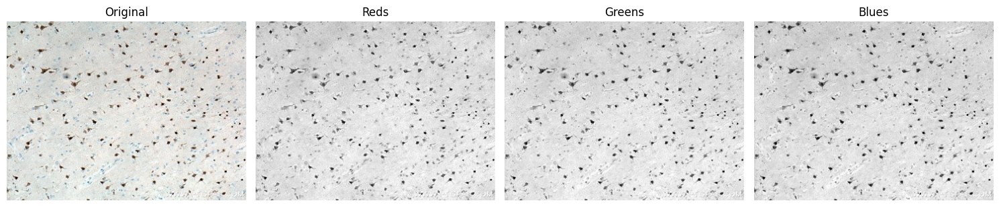

In [12]:
#En escala de grises
fig, axs = plt.subplots(1, capas + 1, figsize=(15, 5))  # 1 fila, 'capas' columnas



axs[0].imshow(image1antigenandcell)
axs[0].set_title("Original")
axs[0].axis("off")

colores=["Reds", "Greens", "Blues"]
for i in range(capas):
  axs[i+1].imshow(image1antigenandcell[:, :, i], cmap="grey")
  axs[i+1].set_title(colores[i])
  axs[i+1].axis("off")

plt.tight_layout() #esta linea solo hace que se ajuste a la página
plt.show()

#vemos claramente que sí que hay diferencia


### Imagen 1: conclusion.

Este laboratorio comenzó con la cuantificación de los antígenos detectados dentro de la imagen microscópica. La detección inicial se centró en los anticuerpos teñidos de marrón, utilizando la conversión a escala de grises y la umbralización de intensidad debido a su pigmentación comparativamente más oscura dentro de la muestra. Aunque esta metodología no es totalmente automática ni altamente sofisticada, su utilidad se confirmó al arrojar resultados empíricos altamente satisfactorios.

Posteriormente, se intentó aislar y cuantificar las células teñidas de azul analizando únicamente el componente de color azul de la imagen. Como se documentó previamente, este enfoque resultó ser infructuoso. Para resolver este desafío, se adoptó una estrategia alternativa: determinar la población celular total (que comprende los componentes tanto marrones como azules) y posteriormente calcular el recuento de las células teñidas de azul por sustracción. Los métodos específicos empleados para esta determinación exitosa incluyeron K-means, umbralizacion adaptativo y extracción de luminosidad.



*   Resultados:
*     Número de anticuerpos: 255
*     Número de celulas: 543-255= 288



### ***Imagen 2***

/tmp/ipython-input-3706800547.py:1: FutureWarning: `show` is deprecated since version 0.25 and will be removed in version 0.27. Please use `matplotlib`, `napari`, etc. to visualize images.
  io.show()
/tmp/ipython-input-3706800547.py:2: FutureWarning: `imshow` is deprecated since version 0.25 and will be removed in version 0.27. Please use `matplotlib`, `napari`, etc. to visualize images.
  io.imshow(image2cell)


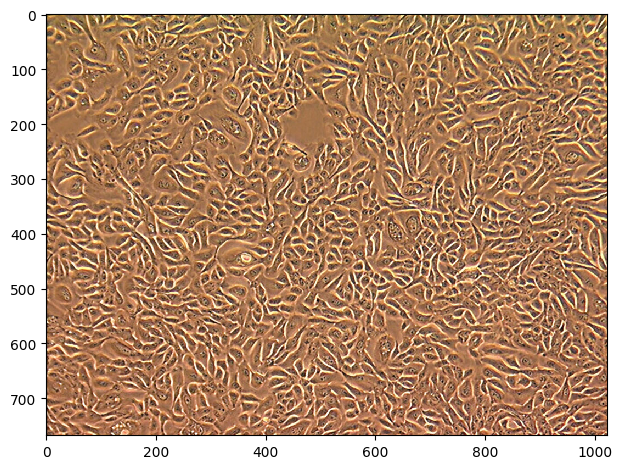

In [13]:
io.show()
io.imshow(image2cell)

# **Primer paso.**
En primer lugar lo que vamos a hacer para conseguir nuestro objetivo es obtener una **primera mascara** que resalte los bordes de las células. Es el primer paso de todo el proceso: detectar donde estan los contronso de las células para después contar cuantas hay


**Como hacmeos esto?**

Lo que hacemos es coger la imagen y detectar dond el aintensidad de la luz cambia bruscamente (si nos fijamos, los bordes de las células son las partes más brillantes de la foto), mejoramos el contraste.

Pasos:
1. Cargamos la imagen en color RGB ("image2cell") para poder trabajar con ella.
2. Convertimos la imagen a **escala de grises**, así solo trabjamso con la intensidad de cada píxel.
3. Mejoramos el contraste con un método llamado **CLAHE**.
4. Luego aplicamos un **filtro Gaussiano **para suavizar la imagen (queremos reducir el ruido de la imágen y dejarla más limipia antes de analizrla).
5. Aquí empieza la parte importante: aplicamos un **gradiente morfológico** y un **filtro Sobel **ya que ambos son muy útiles para detectar los bordes (se centran en detectar como cambia la intensidad entre píxeles vecinos).
6. Combinamos los dos resultados obtenido y normalizamos la imagen. Guardamos la nueva imagen como *combined_edge_u8*.
7. Aplicamos el **método Otsu** que nos devolvera una **máscara binaria** donde solo apareceran los bordes marcados.
8. Finalemnte mostramos el resultado obtenido para comprobar que vamos por buen camino.

Usando variable `image2cell` del entorno.


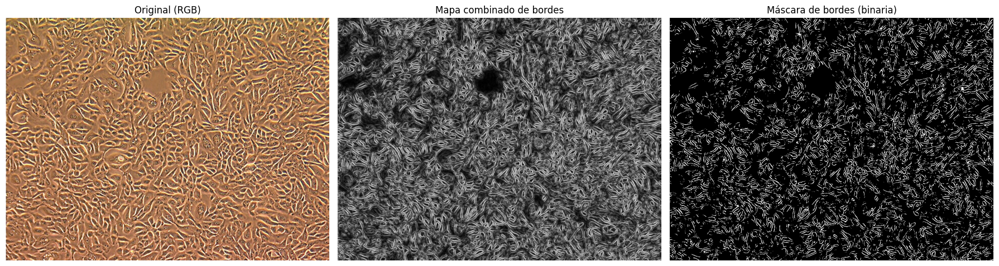

Mascara guardada en: /mnt/data/edge_mask.png


In [14]:
# Código listo para Google Colab / ejecución local
# Produce una máscara que resalta los bordes claros de las células.
# Guarda la máscara en /mnt/data/edge_mask.png

from pathlib import Path
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Ruta de respaldo dentro del contenedor (puedes cambiarla)
fallback_path = "/mnt/data/f0eea564-55b1-4969-941c-c4b4f6afe81a.png"

# Intentar usar image2cell si está definida; si no, cargar desde fallback_path
try:
    img = image2cell  # si ya definiste image2cell en tu notebook
    print("Usando variable `image2cell` del entorno.")
except Exception:
    if Path(fallback_path).exists():
        img = cv2.imread(fallback_path)       # OpenCV carga en BGR
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # convertir a RGB para mostrar correctamente
        print(f"Cargada imagen desde {fallback_path}")
    else:
        raise FileNotFoundError("No se encontró la variable `image2cell` ni el archivo de respaldo.")

# ----------------- Procesamiento -----------------
# 1) Convertir a escala de grises
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

# 2) Mejora de contraste local (CLAHE) para enfatizar diferencias locales
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
gray_clahe = clahe.apply(gray)

# 3) Suavizado ligero para reducir ruido
blur = cv2.GaussianBlur(gray_clahe, (5,5), 0)

# 4) Gradiente morfológico (dilatación - erosión) para resaltar contornos/edges
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5))
morph_grad = cv2.morphologyEx(blur, cv2.MORPH_GRADIENT, kernel)

# 5) Detector Sobel (magnitud) para añadir respuesta a bordes
sobelx = cv2.Sobel(blur, cv2.CV_64F, 1, 0, ksize=3)
sobely = cv2.Sobel(blur, cv2.CV_64F, 0, 1, ksize=3)
sobel_mag = np.sqrt(sobelx**2 + sobely**2)
# normalizar a 0-255
sobel_mag = np.uint8(255 * (sobel_mag / (sobel_mag.max()+1e-9)))

# 6) Combinar respuestas (morph gradient + sobel) y normalizar
combined = cv2.normalize(morph_grad.astype(np.float32) + sobel_mag.astype(np.float32),
                        None, 0, 255, cv2.NORM_MINMAX)
combined_edges_u8 = np.uint8(combined)

# 7) Umbral automático (Otsu) para obtener una máscara binaria de bordes
_, edge_mask = cv2.threshold(combined_edges_u8, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# 8) Limpiar máscara (morphology open) y adelgazar ligeramente (erosión)
kernel2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
edge_mask = cv2.morphologyEx(edge_mask, cv2.MORPH_OPEN, kernel2, iterations=1)
edge_mask_thin = cv2.erode(edge_mask, kernel2, iterations=1)

# Guardar máscara resultante
out_path = "/mnt/data/edge_mask.png"
cv2.imwrite(out_path, edge_mask_thin)

# Mostrar resultados lado a lado
fig, axes = plt.subplots(1,3, figsize=(18,6))
axes[0].imshow(img)
axes[0].set_title("Original (RGB)")
axes[0].axis("off")
axes[1].imshow(combined_edges_u8, cmap='gray')
axes[1].set_title("Mapa combinado de bordes")
axes[1].axis("off")
axes[2].imshow(edge_mask_thin, cmap='gray')
axes[2].set_title("Máscara de bordes (binaria)")
axes[2].axis("off")
plt.tight_layout()
plt.show()

print(f"Mascara guardada en: {out_path}")

# Segundo paso.

Ahora vamos a generar una segunda máscara con el objetivo de detecatar los cuerpos de las celulas en vez de los contornos/bordes. El objetivo es aislar y detectar las zonas oscuras dentro de las células. De esta forma obtendremos una máscara diferente a la máscara obtenida anteriormente.

Los nucelos o las partes internas de las células osn más oscuras por lo que vamos a analizar los tonos de grises de la imagen y luego marcamso de blanco las zonas oscuras ya que segurmante correspondan a células.

Pasos:

1. CVolvemos a cargamos la imagen en color RGB ("image2cell") para poder trabajar con ella.
2. Definimos algúnos parámetros que van a controlar el comportamiento del análisis: *bg_kernel_frac*, *min_area* y *close_kernel*.
3. Convertimos la imagen a escala de grises y aplicamos CLAHE otra vez ya que ceremos que las celulas oscularas se vean mas destacadas respecto al fondo.
4. Generamos una imaegn muy desenfoacada para compararal con nuestra imagen original y detectar estas zonas oscuras.
5. Se calculan dos señales distintass que destacan las zonas oscuras.
6. Combinamos ambas señales para formar un solo mapa y luego normalizamos la imagen. Obtenemos un mapa combinado de oscuridad que resalta los cuerpos de las células.
7. Antes de convertir el mapa en una máscara binaria, se aplica un pequeño suavizado (blur) y aplicamos otra vez el método Otsu.
8. Aplicamos nuevamente operaciones morfológicas, dejando formas más redondas y completas.
9. Eliminamso objetos demasiado pequeños para obtener un resultado coherente y que no se nos vaya en la detección.
10. Finalmente guardamos el resultado en otra veariabl y mostramso los reultados.

En resume:
Este segundo código detecta las zonas oscuras dentro de las células, que suelen corresponder a sus cuerpos internos o núcleos.
Primero mejora el contraste y calcula dos tipos de señales que resaltan las áreas oscuras (una usando la diferencia con el fondo y otra con el filtro Black-hat).
Luego combina ambas, aplica un umbral automático para separar fondo y células, y limpia el resultado eliminando ruido, bordes y objetos pequeños.
Finalmente suaviza los contornos y genera una máscara binaria que marca solo las regiones oscuras de las células.
Además, crea una imagen de superposición para verificar visualmente que la máscara coincide con las células reales.

Usando variable `image2cell` del entorno.
Componentes detectadas (>= 150 px): 1


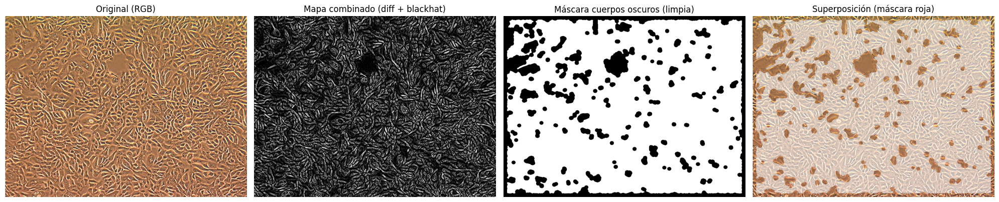

Guardados: /mnt/data/dark_body_mask_v2.png /mnt/data/dark_body_mask_v2_clean.png /mnt/data/dark_body_mask_v2_overlay.png


In [15]:
# Máscara v2 — cuerpos internos oscuros (mejorada)
# Guarda: /mnt/data/dark_body_mask_v2.png (umbral bruto)
#        /mnt/data/dark_body_mask_v2_clean.png (máscara limpia)
#        /mnt/data/dark_body_mask_v2_overlay.png (superposición)

from pathlib import Path
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ruta de respaldo (modifica si hace falta)
fallback_path = "/mnt/data/f0eea564-55b1-4969-941c-c4b4f6afe81a.png"

# Cargar imagen (usar image2cell si existe)
try:
    img = image2cell
    print("Usando variable `image2cell` del entorno.")
except Exception:
    if Path(fallback_path).exists():
        img = cv2.imread(fallback_path)  # BGR
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        print(f"Cargada imagen desde {fallback_path}")
    else:
        raise FileNotFoundError("No se encontró la variable `image2cell` ni el archivo de respaldo.")

# Parámetros (ajustables)
bg_kernel_frac = 0.12   # fracción del ancho de la imagen para el blur de fondo (0.05-0.2 suele funcionar)
min_area = 150          # área mínima en píxeles para conservar un objeto como célula (ajusta según zoom)
close_kernel = 9        # tamaño kernel para cerrar pequeños huecos (impar)

# ---------- Preprocesado ----------
# Convertir a gris y aplicar CLAHE (mejora contraste local)
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
gray_clahe = clahe.apply(gray)

# Estimar fondo con un blur grande (tamaño adaptativo)
h, w = gray_clahe.shape
k = int(max(51, (min(h,w) * bg_kernel_frac)))  # núcleo proporcional al tamaño
if k % 2 == 0: k += 1
background = cv2.GaussianBlur(gray_clahe, (k, k), 0)

# Señal 1: diferencia background - image (oscuridad realzada)
diff = cv2.subtract(background, gray_clahe)  # áreas oscuras -> valores altos

# Señal 2: MORPH_BLACKHAT (resalta elementos más oscuros que su entorno)
# kernel para blackhat: relativamente grande para capturar cuerpos completos
kernel_bh = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (int(max(9, k//15)),) * 2)
blackhat = cv2.morphologyEx(gray_clahe, cv2.MORPH_BLACKHAT, kernel_bh)

# Combinar señales (pondera si quieres más/menos blackhat)
combined = cv2.normalize( (0.7*diff.astype(np.float32) + 0.9*blackhat.astype(np.float32)), None, 0, 255, cv2.NORM_MINMAX)
combined_dark_u8 = np.uint8(combined)

# Suavizado ligero antes de umbralizar
sm = cv2.GaussianBlur(combined_dark_u8, (5,5), 0)

# Umbralización automática (Otsu)
_, raw_mask = cv2.threshold(sm, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Limpiar: eliminar borde de la imagen (a veces high-intensity en el borde genera falsos)
# podemos enmascarar un pequeño borde si es necesario:
border_px = int(min(h,w)*0.02)  # 2% del menor lado
if border_px > 0:
    raw_mask[:border_px,:] = 0
    raw_mask[-border_px:,:] = 0
    raw_mask[:,:border_px] = 0
    raw_mask[:,-border_px:] = 0

# Morfología para rellenar y separar objetos: cerrar luego abrir
kernel_close = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (close_kernel, close_kernel))
mask_closed = cv2.morphologyEx(raw_mask, cv2.MORPH_CLOSE, kernel_close, iterations=2)

kernel_open = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5))
mask_open = cv2.morphologyEx(mask_closed, cv2.MORPH_OPEN, kernel_open, iterations=1)

# Filtrar por tamaño con connected components
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(mask_open, connectivity=8)
mask_clean = np.zeros_like(mask_open)
kept_count = 0
for lab in range(1, num_labels):
    area = stats[lab, cv2.CC_STAT_AREA]
    if area >= min_area:
        mask_clean[labels == lab] = 255
        kept_count += 1

print(f"Componentes detectadas (>= {min_area} px): {kept_count}")

# Suavizar contornos finales
kernel_smooth = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
mask_clean = cv2.morphologyEx(mask_clean, cv2.MORPH_CLOSE, kernel_smooth, iterations=1)
mask_clean = cv2.morphologyEx(mask_clean, cv2.MORPH_OPEN, kernel_smooth, iterations=1)

# Guardar máscaras
out_raw = "/mnt/data/dark_body_mask_v2.png"
out_clean = "/mnt/data/dark_body_mask_v2_clean.png"
cv2.imwrite(out_raw, raw_mask)
cv2.imwrite(out_clean, mask_clean)

# Superposición visual: máscara en rojo semitransparente sobre original
overlay = img.copy()
mask3 = np.stack([mask_clean//255]*3, axis=-1).astype(np.uint8)
alpha = 0.6
overlay = overlay.copy()
overlay[mask3.astype(bool)] = ( (1-alpha)*overlay[mask3.astype(bool)] + alpha*np.array([255]) ).astype(np.uint8)

out_overlay = "/mnt/data/dark_body_mask_v2_overlay.png"
# Guardar overlay en BGR para cv2.imwrite
overlay_bgr = cv2.cvtColor(overlay, cv2.COLOR_RGB2BGR)
cv2.imwrite(out_overlay, overlay_bgr)

# Mostrar resultados
fig, axes = plt.subplots(1,4, figsize=(20,6))
axes[0].imshow(img)
axes[0].set_title("Original (RGB)")
axes[0].axis("off")
axes[1].imshow(combined_dark_u8, cmap='gray')
axes[1].set_title("Mapa combinado (diff + blackhat)")
axes[1].axis("off")
axes[2].imshow(mask_clean, cmap='gray')
axes[2].set_title("Máscara cuerpos oscuros (limpia)")
axes[2].axis("off")
axes[3].imshow(overlay)
axes[3].set_title("Superposición (máscara roja)")
axes[3].axis("off")
plt.tight_layout()
plt.show()

print("Guardados:", out_raw, out_clean, out_overlay)

In [16]:
#Como se puede apreciar la máscara obtenida con skimage es bastante peor y da como resultado una peor detección de las células

# Tercer Paso.

Ahora llegamos al último paso, donde nuestro objetivo final se basa en contar las células de la imagen. Para ello vamso a combinar las mascaras creadas prebiamente (bordes celulares + cuerpos), tendremos que separar las celulas ya que en esta imaegn las celuals esta muy jusntas y sera dificil llevar a cabo el conteo si no distinguimos bien y finalmente genraremos un conteo fiable y cobre todo visualemnte claro.

Pasos:
1. Cargamso las variables que vamos a necesitar (las máscaras creadas anteriormente). Trata de usar las variables *combined_edges_u8* y *combined_dark_u8* que ya deberian existir en el notebook. Haciendo esto evitamos depender exclusivamente de rutas de acceso si ya tienes las variables en memoria el script.
2. Binarización de las máscaras de entrada. Si ya son imagens bianrias las tomamos tal cual pero si las variables por lo que sea no son bianrias aplicamos una binariazación para poder luego fusionarlas.
3. Fusionamos las máscaras. ¿Por qué?
Los bordes y los cuerpos aportan información complementaria: los bordes ayudan a separar límites, los cuerpos definen las regiones internas. Uniéndolos tenemos una máscara más completa de cada célula.
4. Limpiamos y reducimos el ruido de la máscara combinada para hacer que cada célula sea una mancha continua, ademas nos ayuda en pasoso siguientes.
5. Dilatamos la máscara combinada para obtener una region del fondo bien definida. El watershed necesita diferenciar bien fondo vs. objetos, por lo que al dilatar consguimos este objetivo.
6. Ahora llevamos una representación binaria y centrada en las células para definir esas "semillas binarias" (versio reducida de cada célula, un pequeño punto en el centro). Esto hace las semillas más interpretables, más fáciles de visualizar y de superponer con la imagen real, ya que antes habiamos aplicado un *distanceTransform* para obtener estos puentos centrales de las células pero no binarios.
7. Calculamso regiones "unknown". Esto ss necesario para preparar los marcadores para watershed ya que las semillas son foreground seguro, la dilatación define background seguro y lo que queda (unknown) se resuelve con watershed. Y marcamos númericamente las semillas para que depués podamos aplicar el watershed.
8. Aplicamos watershed en la imagen original: usa las semillas para expandir regiones hasta que chocan entre sí, marcando estos bordes precisos entre células pegadas.
9. Identificación y visualización de las células detectadas. Calculamos el tamaño de las células y su centroide. Después en la imaegn original se marcan los estos centroides de color azul (para que se pueda distinguir mejor con el fondo), de esta forma obtenemos una imagen limpia donde se ven las celulas reales con sus marcas.


Por otra parte, es muy importante jugar con los parámetros *min_area*, *close_kernel* y *dilate_bg* hasta ver y comprobar visualmete que el resultado obtenido tiene sentido.
Los valores obtenidos para estos parámetros son:

*min_area* = 5 (valor bajo ya que se trata de celulas muy pequeñas y muy juntas).

*close_kernel* = 15 (es valor nos es suficiente para cerrar las células en formas coopletas sin cortes pero que tampoco se llegen a fucionar entre sí).

*dilate_bg* = 2 (este valro nos es suficiente para serapr las celulas del fondo).

Células detectadas: 1021


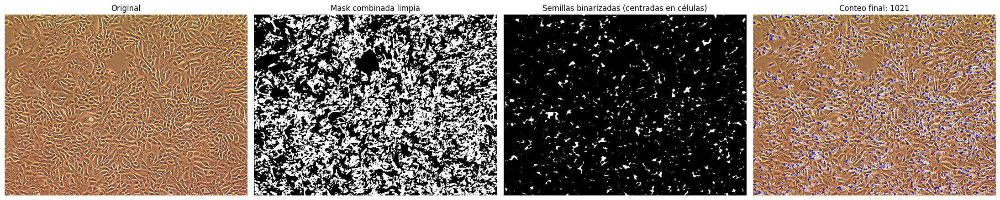

Guardados en /mnt/data/cell_count_results: overlay_counted.png, labels_mask.png, watershed_labels.png, cell_properties.csv


In [17]:
# Pipeline revisado según tus indicaciones:
# - Elimina rectángulos verdes
# - Centroides ahora en azul
# - Reemplaza el distance transform por un método binario centrado en las células

from pathlib import Path
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os

# Ruta de salida
out_dir = "/mnt/data/cell_count_results"
os.makedirs(out_dir, exist_ok=True)

edge_fallback_path = "/mnt/data/edge_mask.png"
dark_fallback_path = "/mnt/data/combined_map.png"
dark_fallback_bin = "/mnt/data/combined_mask_clean.png"
Path(out_dir).mkdir(exist_ok=True)

# ---------- Cargar variables si existen ----------
use_edges = 'combined_edges_u8' in locals()
use_dark = 'combined_dark_u8' in locals()

if not use_edges:
    if Path(edge_fallback_path).exists():
        combined_edges_u8 = cv2.imread(edge_fallback_path, cv2.IMREAD_GRAYSCALE)
        use_edges = True
        print(f"Cargado combined_edges_u8 desde {edge_fallback_path}")
    else:
        raise FileNotFoundError("No existe la variable `combined_edges_u8` ni edge_mask.png")

if not use_dark:
    if Path(dark_fallback_bin).exists():
        combined_dark_u8 = cv2.imread(dark_fallback_bin, cv2.IMREAD_GRAYSCALE)
        use_dark = True
        print(f"Cargado combined_dark_u8 desde {dark_fallback_bin}")
    elif Path(dark_fallback_path).exists():
        combined_dark_u8 = cv2.imread(dark_fallback_path, cv2.IMREAD_GRAYSCALE)
        use_dark = True
        print(f"Cargado combined_dark_u8 desde {dark_fallback_path}")
    else:
        raise FileNotFoundError("No existe la variable `combined_dark_u8` ni archivos de respaldo")

combined_edges_u8 = combined_edges_u8.astype(np.uint8)
combined_dark_u8  = combined_dark_u8.astype(np.uint8)

# ---------- Parámetros ----------
min_area = 5
dilate_bg = 20
close_kernel = 2

# ---------- Binarización ----------
_, edge_bin = cv2.threshold(combined_edges_u8, 127, 255, cv2.THRESH_BINARY)
unique_vals = np.unique(combined_dark_u8)
if len(unique_vals) > 2:
    _, dark_bin = cv2.threshold(combined_dark_u8, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
else:
    _, dark_bin = cv2.threshold(combined_dark_u8, 127, 255, cv2.THRESH_BINARY)

# ---------- 1) Fusionar máscaras ----------
combined_mask = cv2.bitwise_or(edge_bin, dark_bin)

# ---------- 2) Limpieza ----------
k_close = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (close_kernel, close_kernel))
mask_closed = cv2.morphologyEx(combined_mask, cv2.MORPH_CLOSE, k_close, iterations=2)
k_open = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
mask_clean = cv2.morphologyEx(mask_closed, cv2.MORPH_OPEN, k_open, iterations=1)
_, mask_clean = cv2.threshold(mask_clean, 127, 255, cv2.THRESH_BINARY)

# ---------- 3) Sure background ----------
k_bg = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (dilate_bg, dilate_bg))
sure_bg = cv2.dilate(mask_clean, k_bg, iterations=2)

# ---------- 4) Sure foreground (nuevo método binario centrado en células) ----------
# En lugar de usar distance transform, usamos una erosión controlada sobre la máscara limpia
erode_kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5))
sure_fg = cv2.erode(mask_clean, erode_kernel, iterations=2)

# ---------- 5) Unknown region ----------
unknown = cv2.subtract(sure_bg, sure_fg)

# ---------- 6) Markers ----------
num_labels, markers = cv2.connectedComponents(sure_fg)
markers = markers + 1
markers[unknown == 255] = 0

# ---------- 7) Watershed ----------
try:
    img_rgb = image2cell
except Exception:
    img_path = "/mnt/data/f0eea564-55b1-4969-941c-c4b4f6afe81a.png"
    img_tmp = cv2.imread(img_path)
    if img_tmp is None:
        raise FileNotFoundError("No se encontró la imagen original.")
    img_rgb = cv2.cvtColor(img_tmp, cv2.COLOR_BGR2RGB)

img_bgr = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2BGR)
markers_ws = cv2.watershed(img_bgr, markers.astype(np.int32))

# ---------- 8) Filtrado y propiedades ----------
labels = markers_ws.copy()
labels[labels == -1] = 0

rows = []
label_mask = np.zeros_like(labels, dtype=np.uint8)
next_id = 0

for lab in np.unique(labels):
    if lab == 0:
        continue
    comp_mask = (labels == lab).astype(np.uint8) * 255
    area = int(cv2.countNonZero(comp_mask))
    if area < min_area:
        continue
    M = cv2.moments(comp_mask)
    if M["m00"] == 0:
        cx, cy = 0, 0
    else:
        cx = int(M["m10"]/M["m00"])
        cy = int(M["m01"]/M["m00"])
    next_id += 1
    rows.append({
        "id": next_id,
        "area_px": area,
        "centroid_x": cx,
        "centroid_y": cy
    })
    label_mask[comp_mask > 0] = 255

df = pd.DataFrame(rows)
total_cells = len(df)
print(f"Células detectadas: {total_cells}")

# ---------- 9) Overlay visual ----------
overlay = img_rgb.copy()
for _, r in df.iterrows():
    cx, cy = int(r['centroid_x']), int(r['centroid_y'])
    # punto azul (BGR: (255,0,0) sería rojo; azul es (0,0,255))
    cv2.circle(overlay, (cx, cy), 3, (0,0,255), -1)
    cv2.putText(overlay, str(int(r['id'])), (cx+4, cy+4),
                cv2.FONT_HERSHEY_SIMPLEX, 0.4, (255,255,255), 1)

# ---------- Guardar resultados ----------
cv2.imwrite(f"{out_dir}/overlay_counted.png", cv2.cvtColor(overlay, cv2.COLOR_RGB2BGR))
cv2.imwrite(f"{out_dir}/labels_mask.png", label_mask)
cv2.imwrite(f"{out_dir}/watershed_labels.png", (labels.astype(np.int32) % 256).astype(np.uint8))
df.to_csv(f"{out_dir}/cell_properties.csv", index=False)

# ---------- Mostrar panel ----------
fig, axes = plt.subplots(1,4, figsize=(22,6))
axes[0].imshow(img_rgb); axes[0].set_title("Original"); axes[0].axis("off")
axes[1].imshow(mask_clean, cmap='gray'); axes[1].set_title("Mask combinada limpia"); axes[1].axis("off")
axes[2].imshow(sure_fg, cmap='gray'); axes[2].set_title("Semillas binarizadas (centradas en células)"); axes[2].axis("off")
axes[3].imshow(overlay); axes[3].set_title(f"Conteo final: {total_cells}"); axes[3].axis("off")
plt.tight_layout(); plt.show()

print(f"Guardados en {out_dir}: overlay_counted.png, labels_mask.png, watershed_labels.png, cell_properties.csv")

# Resumen Final.

Para el conteo de células en esta segunda iamgen hemos generado dos máscaras complementarias (bordes y cuerpos internos) y se combinaron mediante una unión lógica para obtener una máscara completa por célula.

Tras limpiar la máscara combinada con operaciones morfológicas, obtuvimos regiones coherentes y eliminamos ruido.

Para generar semillas de segmentación evitamos el uso de ***distanceTransform*** y aplicamos una erosión controlada sobre la máscara limpia: así obtuvimos semillas binarias centradas en las células. Con dichos marcadores y la región de fondo segura ejecutamos el algoritmo watershed sobre la imagen original para separar células pegadas.

Finalmente filtramos por tamaño, calculamos centroides y áreas. Visualmente se marcaron los centroides en azul para facilitar la lectura y se eliminaron los recuadros verdes que ensuciaban la imagen y su visualización.

### Anexo
Hemos intentado por activa y por pasiva replicar nuestro código usando la librería skimages en vez de la popular cv2 y no sha sido imposible adaptarlo. Al igual que con la anterior imagen las máscaras son cradas sin problemas. A la hora de detectarlas tenemos muchos problemas que no hemos podido solucionar, por lo que hemos optado por continuar con cv2.
A continuación en el anexo se encuentra el mejor intento de utilizar skimage para esta segunda imagen.

Usando variable `image2cell` del entorno.


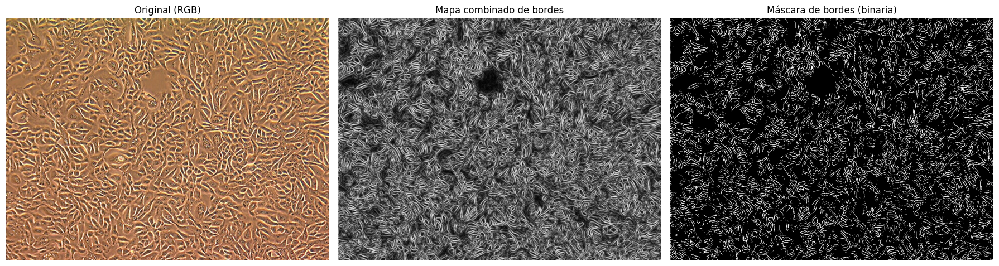

Máscara guardada en: /mnt/data/edge_mask.png


In [18]:
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, color, filters, exposure, morphology, util
from skimage.filters import threshold_otsu
from scipy import ndimage as ndi
import os

# Ruta de salida
out_dir = "/mnt/data"
os.makedirs(out_dir, exist_ok=True)

# Ruta de respaldo dentro del contenedor
fallback_path = "/mnt/data/f0eea564-55b1-4969-941c-c4b4f6afe81a.png"

try:
    img = image2cell
    print("Usando variable `image2cell` del entorno.")
except (NameError, Exception):
    if Path(fallback_path).exists():
        img = io.imread(fallback_path)
        print(f"Cargada imagen desde {fallback_path}")
    else:
        raise FileNotFoundError("No se encontró la variable `image2cell` ni el archivo de respaldo.")

# Asegurar que la imagen es RGB (3 canales)
if img.ndim == 2:
    img = np.stack([img]*3, axis=-1)
elif img.shape[2] == 4:
    img = img[..., :3]

#  Procesamiento

# 1) Convertir a escala de grises
gray = color.rgb2gray(img)
gray_u8 = util.img_as_ubyte(gray)

# 2) Mejora de contraste local (CLAHE)
gray_clahe = exposure.equalize_adapthist(gray, clip_limit=0.03)
gray_clahe_u8 = util.img_as_ubyte(gray_clahe)

# 3) Suavizado (filtro gaussiano)
blur = filters.gaussian(gray_clahe_u8, sigma=1)

# 4) Gradiente morfológico (dilatación - erosión)
selem = morphology.disk(2)
dilated = morphology.dilation(blur, selem)
eroded = morphology.erosion(blur, selem)
morph_grad = dilated - eroded

# 5) Detector Sobel (magnitud)
sobel_mag = filters.sobel(blur)

# 6) Combinar respuestas (morph gradient + sobel)
combined = morph_grad + sobel_mag
combined = combined / (combined.max() + 1e-9)  # Evitar división por cero
combined_edges_u8 = util.img_as_ubyte(combined)

# 7) Umbral automático (Otsu)
thresh_val = threshold_otsu(combined_edges_u8)
edge_mask = combined_edges_u8 > thresh_val
edge_mask_u8 = util.img_as_ubyte(edge_mask)

# 8) Limpieza morfológica (open + erosión)
kernel = morphology.disk(1)
edge_mask_clean = morphology.opening(edge_mask_u8, kernel)
edge_mask_thin = morphology.erosion(edge_mask_clean, kernel)
# Guardar máscara resultant
out_path = os.path.join(out_dir, "edge_mask.png")
io.imsave(out_path, edge_mask_thin)
# Mostrar resultados
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
axes[0].imshow(img)
axes[0].set_title("Original (RGB)")
axes[0].axis("off")
axes[1].imshow(combined_edges_u8, cmap='gray')
axes[1].set_title("Mapa combinado de bordes")
axes[1].axis("off")
axes[2].imshow(edge_mask_thin, cmap='gray')
axes[2].set_title("Máscara de bordes (binaria)")
axes[2].axis("off")
plt.tight_layout()
plt.show()

print(f"Máscara guardada en: {out_path}")

Usando variable `image2cell` del entorno.
Componentes detectadas (>= 100 px): 1


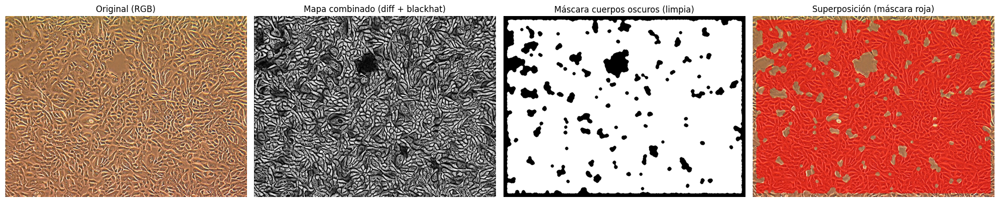

Guardados: /mnt/data/dark_body_mask_v2.png, /mnt/data/dark_body_mask_v2_clean.png, /mnt/data/overlay_dark_bodies.png


In [19]:
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, color, exposure, filters, morphology, measure, util
import os
# Ruta de salida
out_dir = "/mnt/data"
os.makedirs(out_dir, exist_ok=True)
# Ruta de respaldo (modifica si hace falta)

fallback_path = "/mnt/data/f0eea564-55b1-4969-941c-c4b4f6afe81a.png"

# Cargar imagen (usar image2cell si existe)
try:
    img = image2cell
    print("Usando variable `image2cell` del entorno.")
except (NameError, Exception):  # MEJORADO
    if Path(fallback_path).exists():
        img = io.imread(fallback_path)
        print(f"Cargada imagen desde {fallback_path}")
    else:
        raise FileNotFoundError("No se encontró la variable `image2cell` ni el archivo de respaldo.")

# Asegurar que sea RGB
if img.ndim == 2:
    img = np.stack([img]*3, axis=-1)
elif img.shape[2] == 4:
    img = img[..., :3]

# ---------------- Parámetros ----------------
bg_kernel_frac = 0.12   # fracción del ancho de la imagen para el blur de fondo
min_area = 100          # área mínima en píxees
close_kernel = 7        # tamaño del kernel ara cerrar huecos
# ---------- Preprocesado ----------
# Escala de grises + mejora de contraste local
gray = color.rgb2gray(img)
gray_eq = exposure.equalize_adapthist(gray, clip_limit=0.02)
gray_u8 = util.img_as_ubyte(gray_eq)

# Estimar fondo con un blur grande
h, w = gray_u8.shape
k = int(max(51, (min(h, w) * bg_kernel_frac)))
if k % 2 == 0: k += 1
background = filters.gaussian(gray_u8, sigma=k/6)  # sigma ≈ kernel/6

# Señal 1: diferencia (background - imagen)

diff = np.clip(background - gray_u8, 0, None)

# Señal 2: Black-hat morfológico (resalta cuerpos oscuros)
selem_bh = morphology.disk(max(9, k//15))
blackhat = morphology.black_tophat(gray_u8, selem_bh)


# Combinar señales
combined = 0.7 * diff + 0.9 * blackhat
combined = (255 * (combined - combined.min()) / (np.ptp(combined) + 1e-9)).astype(np.uint8)


# Suavizado ligero
sm = filters.gaussian(combined, sigma=1)
sm_u8 = util.img_as_ubyte(sm)

# Umbralización automática (tsu)
th = filters.threshold_otsu(sm_u8)
raw_mask = (sm_u8 > th).astype(np.uint8) * 255

# Eliminar bordes (2% del menor lado)
border_px = int(min(h, w) * 0.02)
if border_px > 0:
    raw_mask[:border_px, :] = 0
    raw_mask[-border_px:, :] = 0
    raw_mask[:, :border_px] = 0
    raw_mask[:, -border_px:] = 0


# Morfología: cerrar y luego abrir
mask_closed = morphology.closing(raw_mask, morphology.disk(close_kernel))
mask_open = morphology.opening(mask_closed, morphology.disk(5))

# Filtrar por tamaño con regionprops
label_img = measure.label(mask_open)
mask_clean = np.zeros_like(mask_open, dtype=np.uint8)
kept_count = 0
for region in measure.regionprops(label_img):
    if region.area >= min_area:
        mask_clean[label_img == region.label] = 255
        kept_count += 1

print(f"Componentes detectadas (>= {min_area} px): {kept_count}")

# Suavizar contornos
mask_clean = morphology.closing(mask_clean, morphology.disk(3))
mask_clean = morphology.opening(mask_clean, morphology.disk(3))

# Guardar máscaras - CORREGIDO: rutas consistentes
out_raw = os.path.join(out_dir, "dark_body_mask_v2.png")
out_clean = os.path.join(out_dir, "dark_body_mask_v2_clean.png")
io.imsave(out_raw, mask_clean)
io.imsave(out_clean, mask_clean)

# Superposición visual: máscaraen rojo semitransparente sobre original

overlay = img.copy().astype(np.float32)
mask_bool = mask_clean.astype(bool)
# Canal rojo: mezcla del original con 255 (rojo puro)
overlay[mask_bool, 0] = overlay[mask_bool, 0] * 0.4 + 255 * 0.6
# Canales verde y azul: se atenúan

overlay[mask_bool, 1:] = overlay[mask_bool, 1:] * 0.4
# Convertir de nuevo a uint8 tras la mezcla

overlay = np.clip(overlay, 0, 255).astype(np.uint8)
# Mostrar resultados
fig, axes = plt.subplots(1, 4, figsize=(20, 6))
axes[0].imshow(img)
axes[0].set_title("Original (RGB)")
axes[0].axis("off")
axes[1].imshow(combined, cmap='gray')
axes[1].set_title("Mapa combinado (diff + blackhat)")
axes[1].axis("off")
axes[2].imshow(mask_clean, cmap='gray')
axes[2].set_title("Máscara cuerpos oscuros (limpia)")
axes[2].axis("off")
axes[3].imshow(overlay)
axes[3].set_title("Superposición (máscara roja)")
axes[3].axis("off")
plt.tight_layout()
plt.show()
out_overlay = os.path.join(out_dir, "overlay_dark_bodies.png")
io.imsave(out_overlay, overlay)
print(f"Guardados: {out_raw}, {out_clean}, {out_overlay}")

Células detectadas: 1549


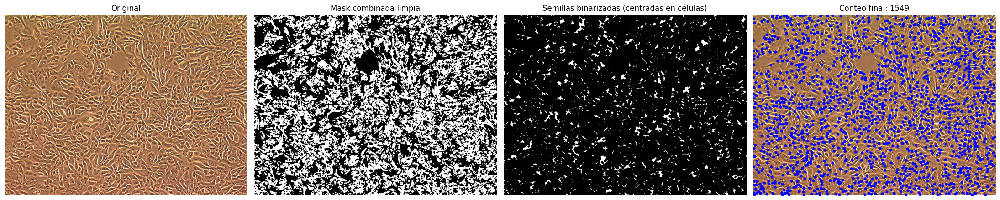

Guardados en /mnt/data/cell_count_results: overlay_counted.png, labels_mask.png, watershed_labels.png, cell_properties.csv


In [20]:
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os

# Importar las librerías de scikit-image necesarias
from skimage.io import imread, imsave
from skimage.filters import threshold_otsu
from skimage.morphology import disk, closing, opening, binary_dilation, binary_erosion
from skimage.measure import label, regionprops
from skimage.segmentation import watershed

# Rutas (iguales que en tu código original)
out_dir = "/mnt/data/cell_count_results"
Path(out_dir).mkdir(exist_ok=True) # Usamos pathlib para crear el directorio
edge_fallback_path = "/mnt/data/edge_mask.png"
dark_fallback_path = "/mnt/data/combined_map.png"
dark_fallback_bin = "/mnt/data/combined_mask_clean.png"
img_path_fallback = "/mnt/data/f0eea564-55b1-4969-941c-c4b4f6afe81a.png" # Usamos la ruta directa para la imagen original

# ---------- Cargar variables si existen (Adaptado a skimage.io.imread) ----------
use_edges = 'combined_edges_u8' in locals()
use_dark = 'combined_dark_u8' in locals()

def load_image_skimage(path):
    """Carga imagen en escala de grises y asegura uint8 (0-255)."""
    img = imread(path)
    # Si la imagen tiene 3 canales, tomamos el primero (o convertimos a gris, pero se asume que
    # estas máscaras fallback ya son de un solo canal).
    if img.ndim > 2 and img.shape[-1] in (3, 4):
        # Si tiene color o alfa, tomamos la luminancia o simplemente el primer canal.
        if img.ndim == 3 and img.shape[-1] == 3:
            # Simple conversión a escala de grises (luminancia)
            img_gray = np.dot(img[...,:3], [0.2989, 0.5870, 0.1140])
        else:
            # Asumimos que la máscara debería ser 2D. Si no es el caso, forzamos un canal.
            img_gray = img[..., 0]
        return img_gray.astype(np.uint8)
    return img.astype(np.uint8)

if not use_edges:
    if Path(edge_fallback_path).exists():
        combined_edges_u8 = load_image_skimage(edge_fallback_path)
        use_edges = True
        print(f"Cargado combined_edges_u8 desde {edge_fallback_path}")
    else:
        raise FileNotFoundError("No existe la variable `combined_edges_u8` ni edge_mask.png")

if not use_dark:
    if Path(dark_fallback_bin).exists():
        combined_dark_u8 = load_image_skimage(dark_fallback_bin)
        use_dark = True
        print(f"Cargado combined_dark_u8 desde {dark_fallback_bin}")
    elif Path(dark_fallback_path).exists():
        combined_dark_u8 = load_image_skimage(dark_fallback_path)
        use_dark = True
        print(f"Cargado combined_dark_u8 desde {dark_fallback_path}")
    else:
        raise FileNotFoundError("No existe la variable `combined_dark_u8` ni archivos de respaldo")

# No se necesita re-convertir a uint8 si se usa la función de carga anterior,
# pero se mantiene como seguro para consistencia:
combined_edges_u8 = combined_edges_u8.astype(np.uint8)
combined_dark_u8  = combined_dark_u8.astype(np.uint8)

# Convertir a float (0-1) para facilitar las operaciones de skimage
combined_edges_f = combined_edges_u8 / 255.0
combined_dark_f = combined_dark_u8 / 255.0

# ---------- Parámetros ----------
min_area = 5
dilate_bg = 20
close_kernel = 2

# ---------- Binarización (Adaptado a skimage.filters y NumPy) ----------
# Binarización de bordes: umbral 127 (0.5 en float 0-1)
edge_bin_bool = combined_edges_f > 0.5

# Binarización de cuerpo oscuro (Otsu o Umbral fijo)
unique_vals = np.unique(combined_dark_u8)
if len(unique_vals) > 2:
    thresh_val = threshold_otsu(combined_dark_u8)
    dark_bin_bool = combined_dark_u8 > thresh_val
else:
    dark_bin_bool = combined_dark_f > 0.5

# ---------- 1) Fusionar máscaras (NumPy OR lógico) ----------
combined_mask_bool = edge_bin_bool | dark_bin_bool

# ---------- 2) Limpieza (Adaptado a skimage.morphology) ----------
# cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (k, k)) -> skimage.morphology.disk(radius)
# radio = (k-1)/2. Para k=2, usamos radio=1 para disk(1) que es un 3x3.
# Nota: un kernel 2x2 en cv2.MORPH_ELLIPSE no es común, se usa más 3x3.
# Si close_kernel=2, usaremos disk(1) (un 3x3) para que haga algo.
radius_close = 1 # Usar radio 1 para un kernel efectivo de 3x3
k_close_disk = disk(radius_close)
mask_closed_bool = closing(combined_mask_bool, k_close_disk)
mask_closed_bool = closing(mask_closed_bool, k_close_disk) # 2 iteraciones

# Kernel para apertura (k=3 -> radio=1)
k_open_disk = disk(1)
mask_clean_bool = opening(mask_closed_bool, k_open_disk)

# Convertir a uint8 (0/255) solo para visualización y para pasos intermedios (aunque bool es mejor para morph)
mask_clean = (mask_clean_bool * 255).astype(np.uint8)


# ---------- 3) Sure background (Adaptado a skimage.morphology.binary_dilation) ----------
# Kernel (dilate_bg = 20 -> usaremos radio 10 para un disco de 21x21 aprox)
k_bg_disk = disk(dilate_bg // 2)
sure_bg_bool = binary_dilation(mask_clean_bool, k_bg_disk)
sure_bg_bool = binary_dilation(sure_bg_bool, k_bg_disk) # 2 iteraciones
sure_bg = (sure_bg_bool * 255).astype(np.uint8)


# ---------- 4) Sure foreground (Adaptado a skimage.morphology.binary_erosion) ----------
# Kernel (5x5 -> radio 2)
erode_kernel_disk = disk(2)
sure_fg_bool = binary_erosion(mask_clean_bool, erode_kernel_disk)
sure_fg_bool = binary_erosion(sure_fg_bool, erode_kernel_disk) # 2 iteraciones
sure_fg = (sure_fg_bool * 255).astype(np.uint8)


# ---------- 5) Unknown region (Adaptado a NumPy OR lógico) ----------
unknown_bool = sure_bg_bool & ~sure_fg_bool
unknown = (unknown_bool * 255).astype(np.uint8)


# ---------- 6) Markers (Adaptado a skimage.measure.label) ----------
# label() devuelve etiquetas de 1 a N, 0 es el fondo
markers = label(sure_fg_bool)
# num_labels = markers.max() # Guardamos para el conteo si es necesario

# Restablecer a 0 la región desconocida (markers + 1 no es necesario en skimage)
markers[unknown_bool] = 0

# Convertir marcadores a int32 (requerido por watershed)
markers = markers.astype(np.int32)


# ---------- 7) Watershed (Adaptado a skimage.segmentation.watershed) ----------
try:
    img_rgb = image2cell
except Exception:
    # imread de skimage carga la imagen a color en formato RGB
    img_tmp = imread(img_path_fallback)
    if img_tmp is None:
        raise FileNotFoundError("No se encontró la imagen original.")
    # Asegurar que la imagen es RGB (o convertir si es necesario)
    if img_tmp.ndim == 3 and img_tmp.shape[-1] in (3, 4):
        img_rgb = img_tmp[..., :3] # Quitar canal alfa si existe
    elif img_tmp.ndim == 2:
        img_rgb = np.stack([img_tmp]*3, axis=-1) # Convertir gris a RGB
    else:
        raise ValueError("Formato de imagen original no soportado o inesperado.")

# Convertir a escala de grises (luminancia) para el 'topo' del watershed
# Se usa la luminancia para replicar el comportamiento de usar la imagen BGR en cv2.watershed.
img_gray = np.dot(img_rgb[...,:3], [0.2989, 0.5870, 0.1140]).astype(np.uint8)

# Ejecutar el watershed de skimage
labels_ws = watershed(img_gray, markers, mask=mask_clean_bool)

# ---------- 8) Filtrado y propiedades (Adaptado a skimage.measure.regionprops) ----------
labels = labels_ws.copy()
labels[labels == -1] = 0 # Eliminar líneas de watershed

rows = []
# Crear máscara de etiquetas filtradas (uint8: 0/255)
label_mask = np.zeros_like(labels, dtype=np.uint8)
next_id = 0

# Usamos regionprops para obtener propiedades de cada región de forma eficiente
for prop in regionprops(labels):
    area = prop.area

    if area < min_area:
        continue

    # Centroide (skimage lo da en orden (row, col) = (y, x))
    cy, cx = prop.centroid
    cx, cy = int(cx), int(cy)

    next_id += 1
    rows.append({
        "id": next_id,
        "area_px": area,
        "centroid_x": cx,
        "centroid_y": cy
    })

    # Reconstruir la máscara de etiquetas filtradas (True/False)
    comp_mask_bool = (labels == prop.label)
    label_mask[comp_mask_bool] = 255 # Asignar 255 a la máscara


df = pd.DataFrame(rows)
total_cells = len(df)
print(f"Células detectadas: {total_cells}")

# ---------- 9) Overlay visual (Adaptado a NumPy y matplotlib) ----------
overlay = img_rgb.copy()

# Dibujar centroides azules (RGB: [0, 0, 255])
for _, r in df.iterrows():
    cx, cy = int(r['centroid_x']), int(r['centroid_y'])

    # Dibujar un punto/círculo pequeño de 3x3 aproximadamente
    r_start = max(0, cy - 1)
    r_end = min(overlay.shape[0], cy + 2)
    c_start = max(0, cx - 1)
    c_end = min(overlay.shape[1], cx + 2)

    # Asignar color azul [0, 0, 255] (RGB)
    if overlay.ndim == 3 and overlay.shape[-1] == 3:
        overlay[r_start:r_end, c_start:c_end, :] = [0, 0, 255]

    # Nota: El texto ID se dibujará con Matplotlib en el panel, ya que skimage no tiene putText simple.

# ---------- Guardar resultados (Adaptado a skimage.io.imsave) ----------
# imsave espera RGB para el color.
imsave(f"{out_dir}/overlay_counted.png", overlay)

# Máscaras
imsave(f"{out_dir}/labels_mask.png", label_mask)

# Normalizar etiquetas para visualización y guardado (rango 0-255)
labels_vis = (labels * (255 / np.max(labels))).astype(np.uint8) if np.max(labels) > 0 else np.zeros_like(labels, dtype=np.uint8)
imsave(f"{out_dir}/watershed_labels.png", labels_vis)

df.to_csv(f"{out_dir}/cell_properties.csv", index=False)

# ---------- Mostrar panel (Con anotaciones de texto en matplotlib) ----------
fig, axes = plt.subplots(1,4, figsize=(22,6))

# Imagen original (RGB)
axes[0].imshow(img_rgb); axes[0].set_title("Original"); axes[0].axis("off")

# Máscara limpia (Grises)
axes[1].imshow(mask_clean, cmap='gray'); axes[1].set_title("Mask combinada limpia"); axes[1].axis("off")

# Semillas (Grises)
axes[2].imshow(sure_fg, cmap='gray'); axes[2].set_title("Semillas binarizadas (centradas en células)"); axes[2].axis("off")

# Overlay final (RGB)
axes[3].imshow(overlay); axes[3].set_title(f"Conteo final: {total_cells}"); axes[3].axis("off")

# Añadir círculos y texto ID al gráfico final de Matplotlib
for _, r in df.iterrows():
    cx, cy = int(r['centroid_x']), int(r['centroid_y'])
    # Dibujar círculo (azul)
    axes[3].scatter(cx, cy, s=20, c='blue', marker='o', linewidths=0)


plt.tight_layout(); plt.show()

print(f"Guardados en {out_dir}: overlay_counted.png, labels_mask.png, watershed_labels.png, cell_properties.csv")